#importing libraries

In [30]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split as tts
from sklearn.datasets import fetch_olivetti_faces
from sklearn.cluster import DBSCAN
import random
from sklearn.datasets import make_moons

#Problem 1

##Part 1



In [ ]:
df=pd.read_csv('https://archive.ics.uci.edu/ml/machine-learning-databases/glass/glass.data',names=["ID","RI","Na","Mg","Al","Si","K","Ca","Ba","Fe","Type"])
df.head()

,ID,RI,Na,Mg,Al,Si,K,Ca,Ba,Fe,Type
0,1,1.52101,13.64,4.49,1.10,71.78,0.06,8.75,0.0,0.0,1
1,2,1.51761,13.89,3.60,1.36,72.73,0.48,7.83,0.0,0.0,1
2,3,1.51618,13.53,3.55,1.54,72.99,0.39,7.78,0.0,0.0,1
3,4,1.51766,13.21,3.69,1.29,72.61,0.57,8.22,0.0,0.0,1
4,5,1.51742,13.27,3.62,1.24,73.08,0.55,8.07,0.0,0.0,1


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214 entries, 0 to 213
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ID      214 non-null    int64  
 1   RI      214 non-null    float64
 2   Na      214 non-null    float64
 3   Mg      214 non-null    float64
 4   Al      214 non-null    float64
 5   Si      214 non-null    float64
 6   K       214 non-null    float64
 7   Ca      214 non-null    float64
 8   Ba      214 non-null    float64
 9   Fe      214 non-null    float64
 10  Type    214 non-null    int64  
dtypes: float64(9), int64(2)
memory usage: 18.5 KB


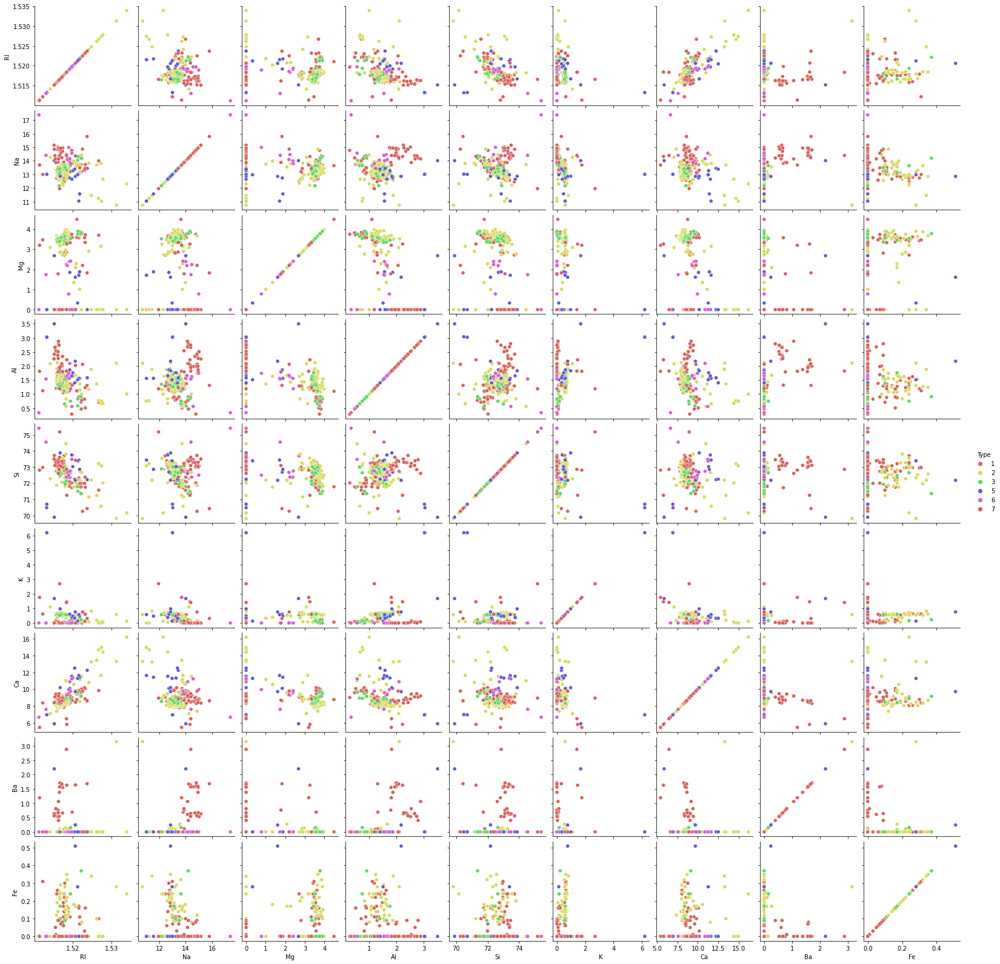

In [ ]:
sns.pairplot(data=df.drop('ID',axis=1),hue='Type',palette='hls',diag_kind=None)

In [ ]:
X=df.drop(['ID','Type'],axis=1)
y=df['Type']
model=KMeans(n_clusters=7,random_state=42)
model.fit(X)

/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=7, random_state=42)

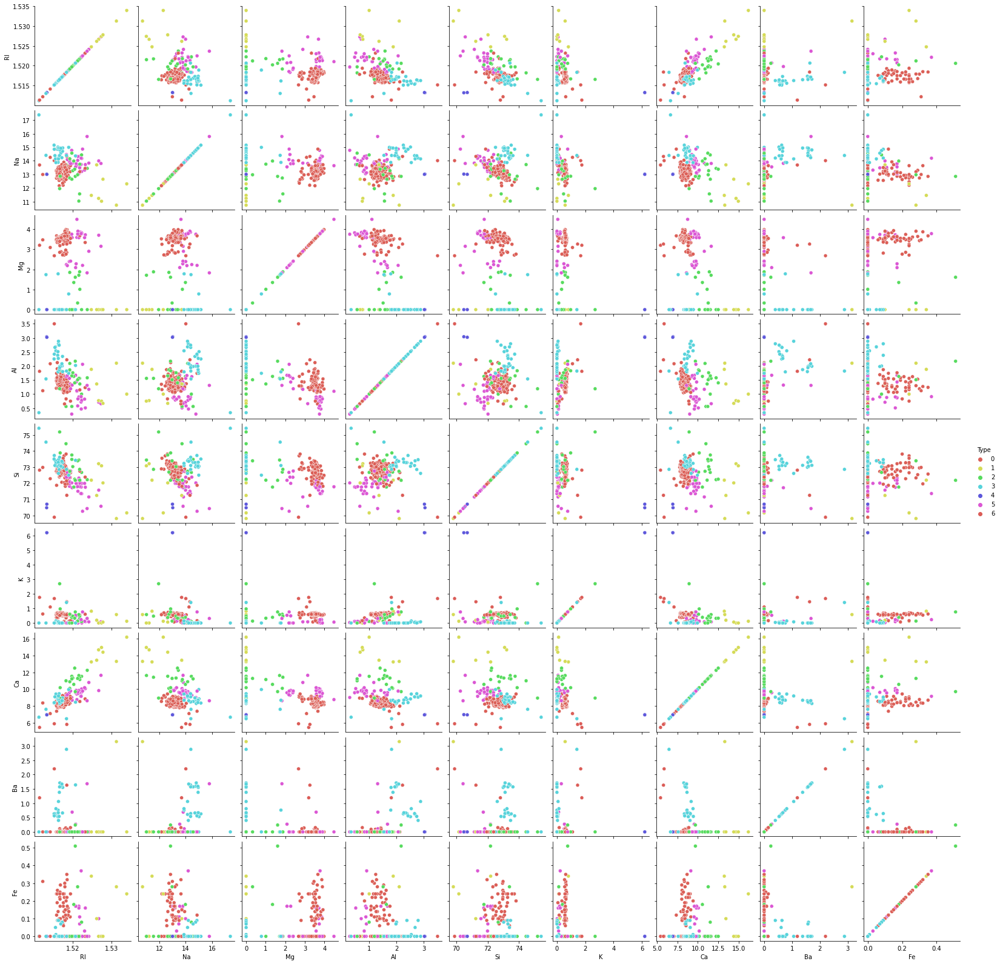

In [ ]:
y_pred=model.predict(X)
new_df=df.copy()
new_df['Type']=y_pred
sns.pairplot(data=new_df.drop('ID',axis=1),hue='Type',palette='hls',diag_kind=None)



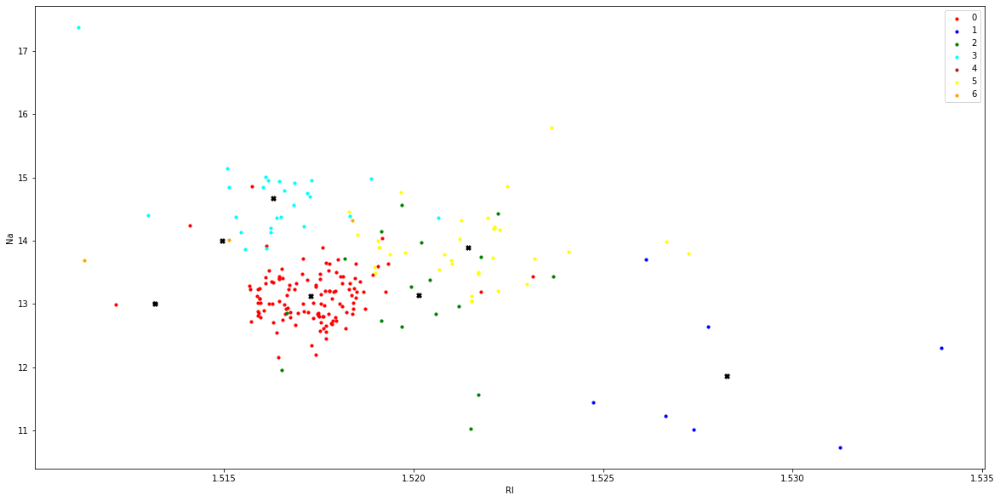

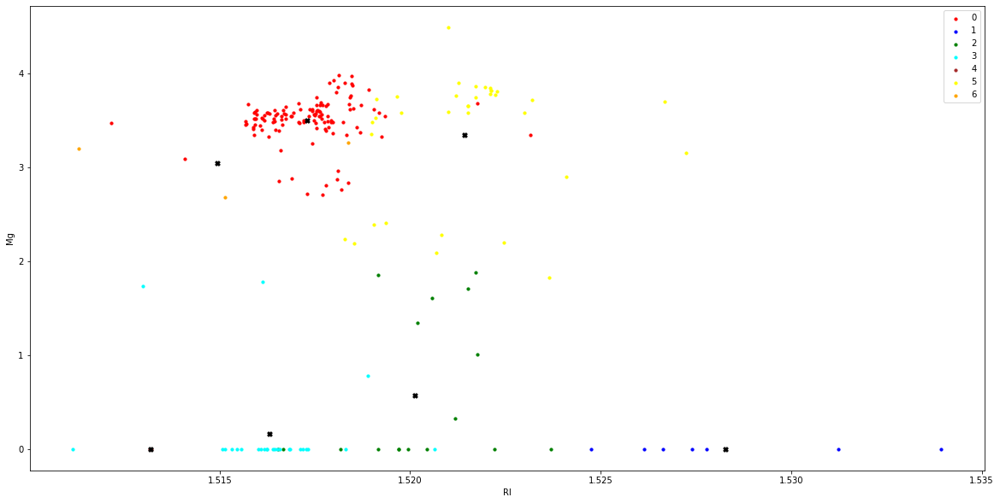

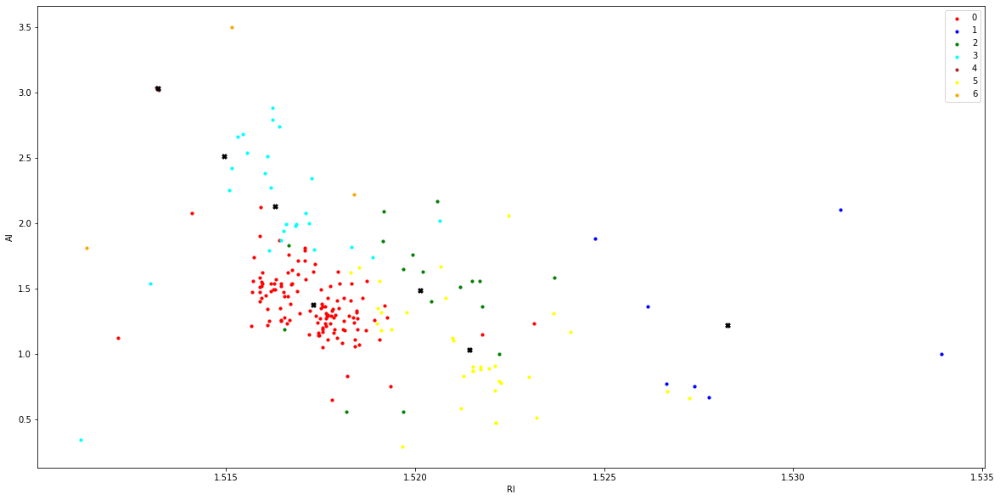

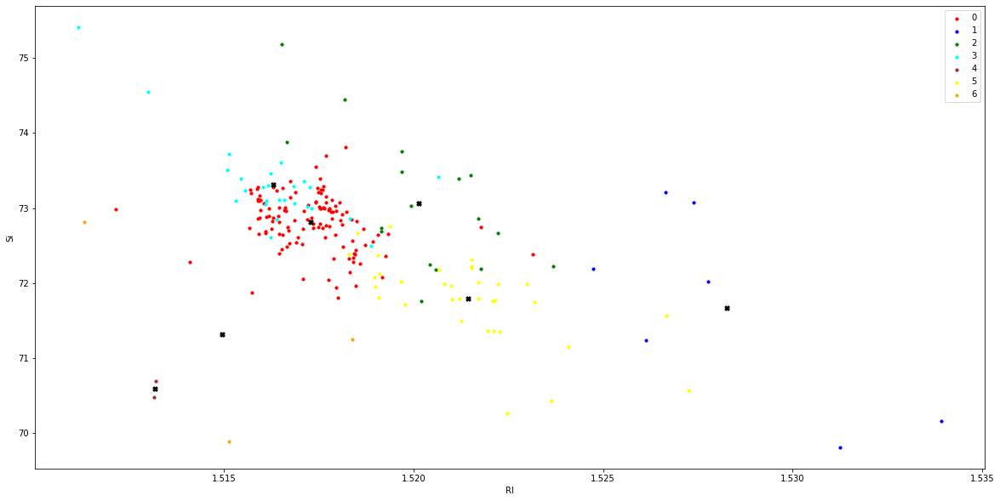

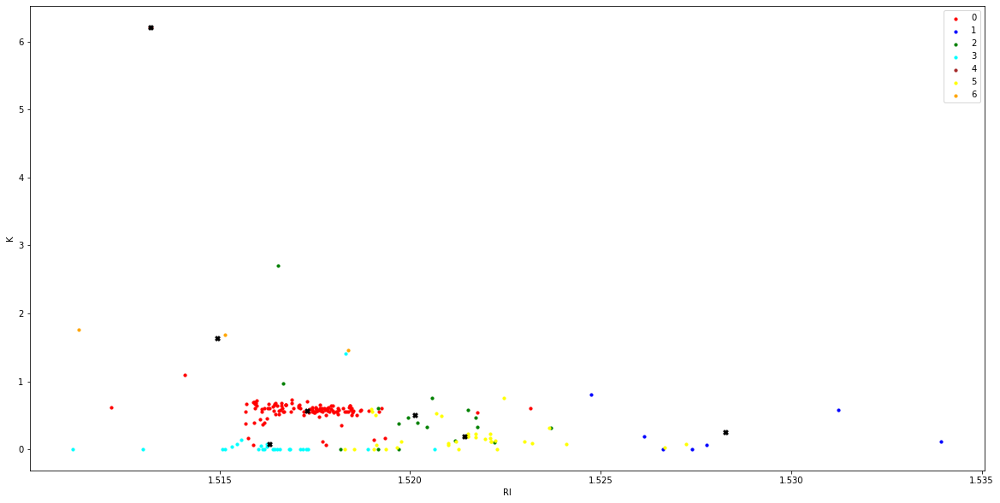

...

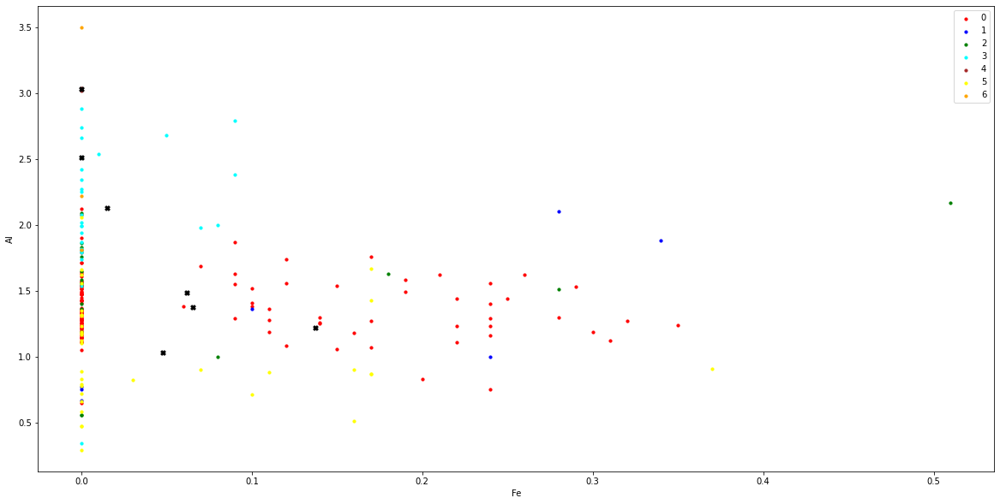

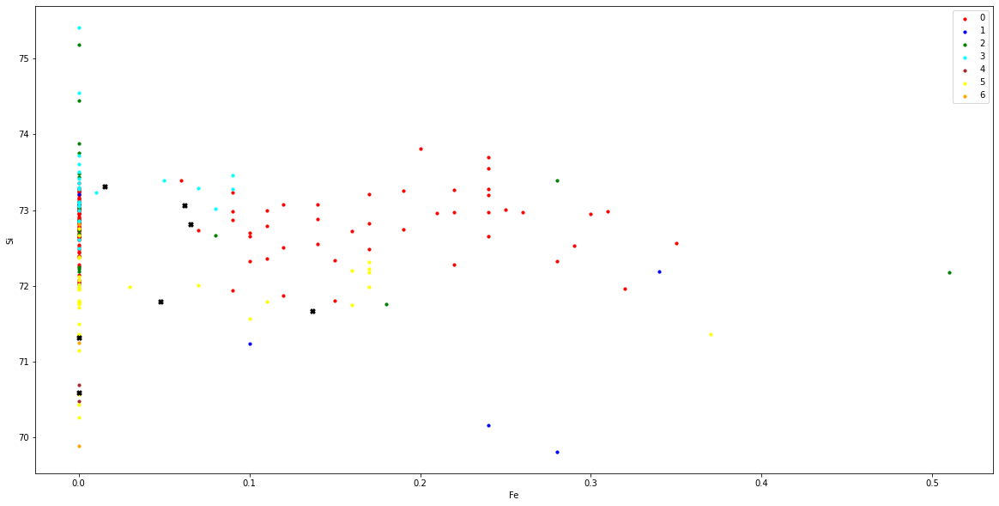

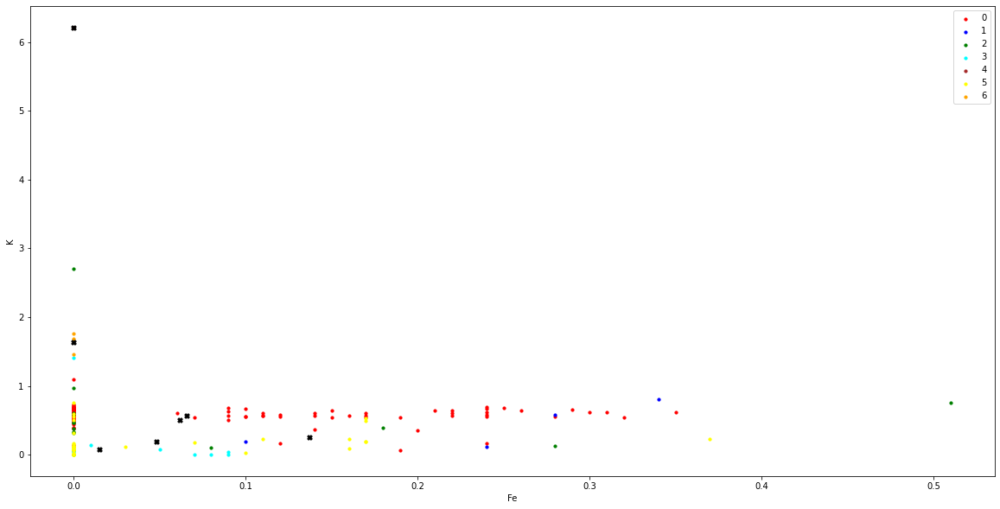

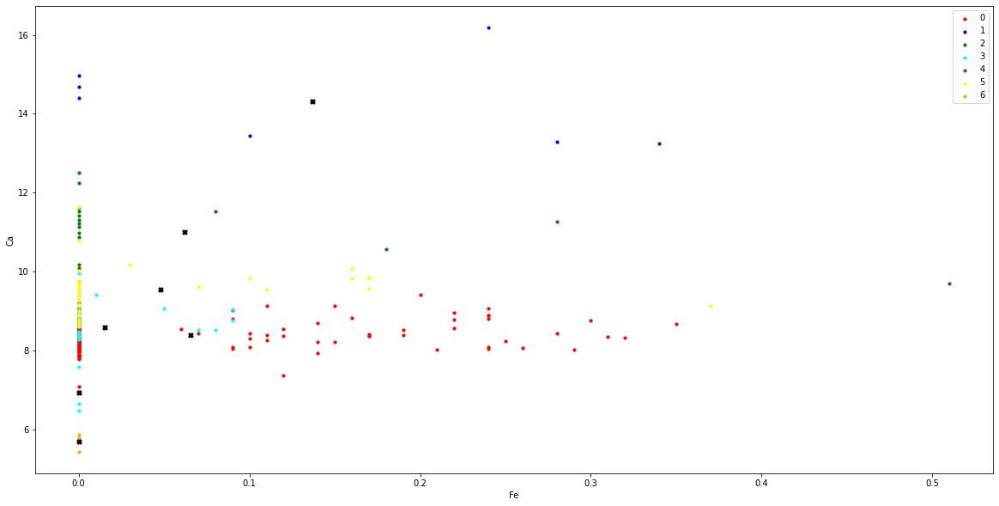

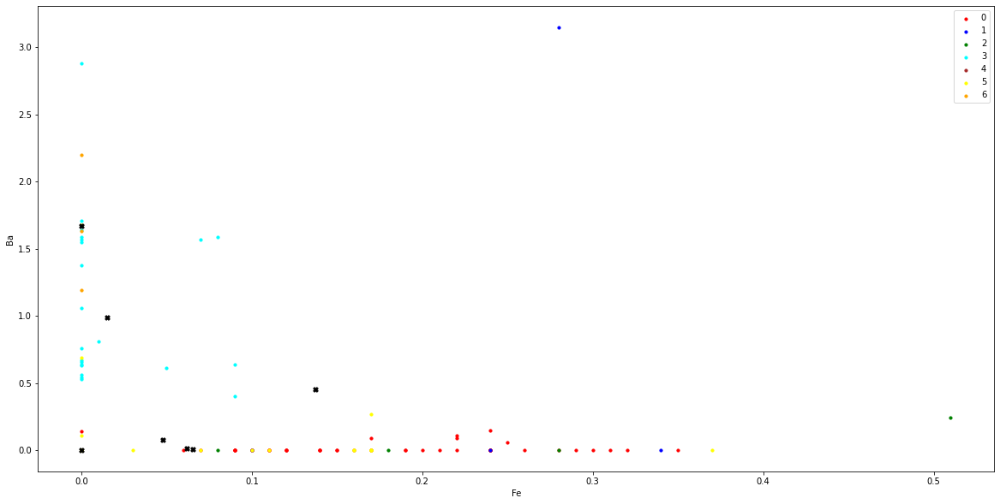

In [ ]:
plt.rcParams['figure.figsize'] = [20, 10]
color=['red','blue','green','cyan','brown','yellow','orange']
centeroids=model.cluster_centers_

for header_x in range(len(X.columns)):
    for header_y in range(len(X.columns)):
        if(header_x==header_y):
            continue
        
        
        for i in range(7):
            idx=np.where(y_pred==i)[0]
            
            plt.scatter(X.iloc[idx,header_x],X.iloc[idx,header_y],color=color[i],label=i,s=10)
        plt.scatter(centeroids[:,header_x],centeroids[:,header_y],marker='X',s=30,color='black')
        plt.xlabel(X.columns[header_x])
        plt.ylabel(X.columns[header_y])
        plt.legend()
        plt.show()




##Part 2

4


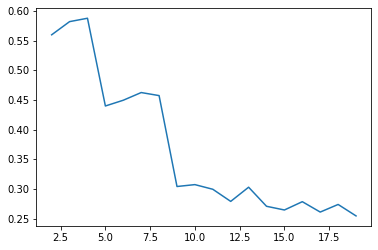

In [ ]:
Silhouette_scores=[]
for n_clusters in range(2,20):
    temp_model=KMeans(n_clusters=n_clusters,random_state=42)
    temp_model.fit(X)
    temp_y_pred=temp_model.predict(X)
    Silhouette_scores.append(silhouette_score(X,temp_y_pred))

# print(Silhouette_scores.argmax()+2)
plt.plot(range(2,20),Silhouette_scores)
argmx=Silhouette_scores.index(max(Silhouette_scores))
print(argmx+2)


##Part 3

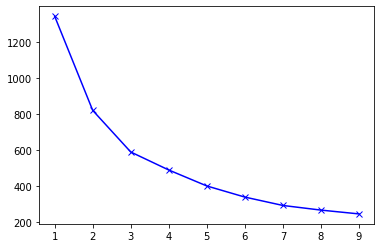

In [ ]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(X)
    distortions.append(kmeanModel.inertia_)
plt.plot(K,distortions,'bx-')

##Part 4


In [ ]:
X_train,X_test,y_train,y_test=tts(X,y,test_size=0.3,shuffle=True,random_state=42)

In [ ]:
for k in [1,2,3]:
    knn_model=KNeighborsClassifier(n_neighbors=k)
    knn_model.fit(X_train,y_train)
    print('accuracy of single knn model on k=',k,'is',knn_model.score(X_test,y_test))

    knn=KNeighborsClassifier(n_neighbors=k)
    Bagg_clf=BaggingClassifier(estimator=knn,n_estimators=10)
    Bagg_clf.fit(X_train,y_train)
    print('accuracy of bagging classifier on k=',k,'is',Bagg_clf.score(X_test,y_test))

accuracy of single knn model on k= 1 is 0.7692307692307693
accuracy of bagging classifier on k= 1 is 0.7538461538461538
accuracy of single knn model on k= 2 is 0.6615384615384615
accuracy of bagging classifier on k= 2 is 0.7230769230769231
accuracy of single knn model on k= 3 is 0.6461538461538462
accuracy of bagging classifier on k= 3 is 0.676923076923077


#Problem 2

##Part 1


In [ ]:
of = fetch_olivetti_faces()
df=pd.DataFrame(of.data)
df['Class']=of.target
df.isna().sum().sum()


downloading Olivetti faces from https://ndownloader.figshare.com/files/5976027 to /root/scikit_learn_data


0

In [ ]:
X=df.drop('Class',axis=1)
y=df['Class']

In [ ]:
class KMeans_Scratch:
    #initialized the classifier with no of clusters (k) and max no of iterations to perfrom
    def __init__(self,k,max_iter):
        self.k=k
        self.max_iter=max_iter

    #function to calculate euclidian distance between two points
    def __distance(self,x,y):
        distance=(x-y)**2
        distance=np.sqrt(distance.sum())
        return distance

    #function to assign clusters/ labels to the datapoints once the centroids are decided
    def __assign_clusters(self,X,centroids):
        clusters=[]
        for _ in range(self.k):
            clusters.append([])
        for x in X:
            # print(x)
            distance=[]
            for centroid in centroids:
                distance.append(self.__distance(x,centroid))
            clusters[distance.index(min(distance))].append(x)
        return clusters
            
    #function to update the centroids after each iteration
    def __update_centroids(self,clusters):
        means=[np.mean(cluster,axis=0) for cluster in clusters]
        return np.array(means)

    #function to train the classifier on a dataset X
    def train(self,X,ini_centroids):
        #initializing the centroids with ini_centroids got as parameter in input
        centroids=ini_centroids
        cnt=0
        for _ in range(self.max_iter):
            cnt+=1
            #assigning the datapoints to each cluster
            clusters=self.__assign_clusters(X,centroids)
            #calculating new centroids
            new_centroids=self.__update_centroids(clusters)
            #once we started getting same value of centroids twice, stop the iteration
            if(np.all(new_centroids==centroids)):
                # print(centroids,new_centroids)
                break
            centroids=new_centroids
        # print('cnt',cnt)
        self.cluster_centers_=centroids
        self.clusters=self.__assign_clusters(X,centroids)

    #function to predict label for a single sample. It will calculate the distance of x from each centroid and assign to one with which it has minimum distance
    def predict(self,x):
        distance=[]
        for centroid in self.cluster_centers_:
            distance.append(self.__distance(x,centroid))
        return distance.index(min(distance))

    #function to predict labels for dataset X consisting multiple samples.
    def test(self,X):
        preds=[]
        for x in X:
            preds.append(self.predict(x))
        return preds

    


idx=np.random.choice(400,40,replace=False)
# print(X)
init_centroids=X.iloc[idx,:].to_numpy()
clf=KMeans_Scratch(40,1000)
clf.train(X.to_numpy(),init_centroids)
clusters=clf.clusters
no_of_datapoints_in_cluster=[]
for cluster in clusters:
    no_of_datapoints_in_cluster.append(len(cluster))
print(no_of_datapoints_in_cluster)







[10, 5, 14, 6, 8, 6, 5, 2, 3, 5, 2, 8, 13, 20, 8, 12, 5, 4, 12, 20, 9, 20, 19, 4, 10, 21, 23, 5, 2, 20, 10, 11, 10, 6, 22, 3, 4, 11, 6, 16]


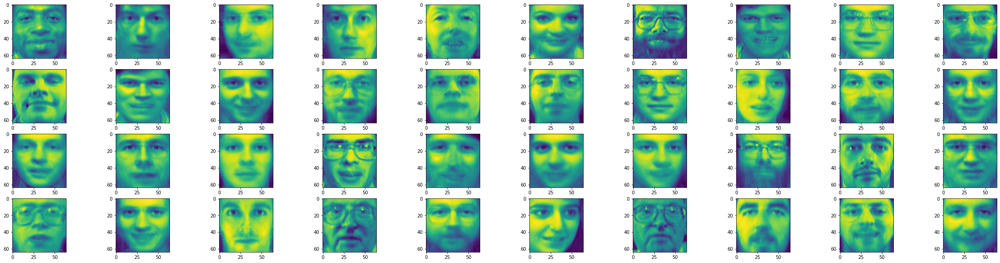

In [ ]:
idx=1
plt.rcParams['figure.figsize'] = [40, 10]
for x in clf.cluster_centers_:
    plt.subplot(4,10,idx)
    idx+=1
    plt.imshow(x.reshape(64,64))
plt.show()

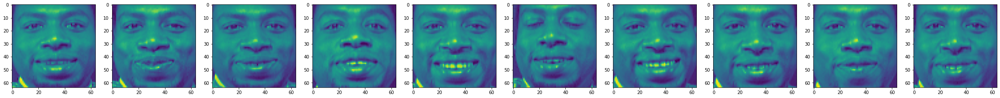

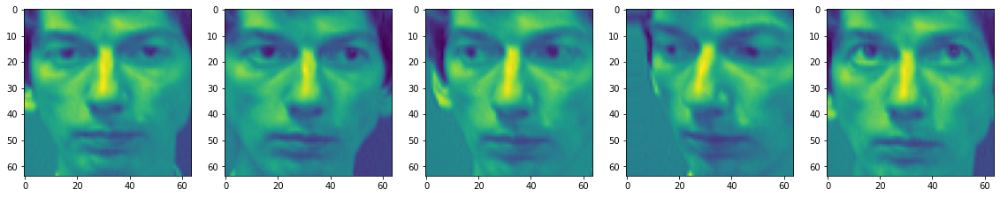

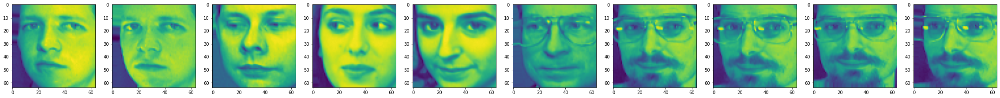

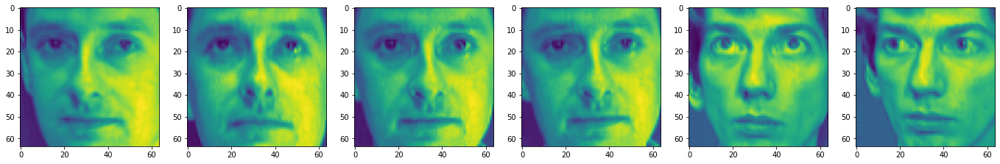

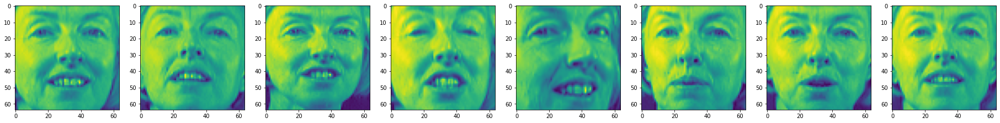

...

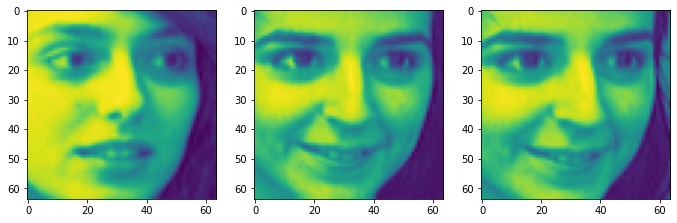

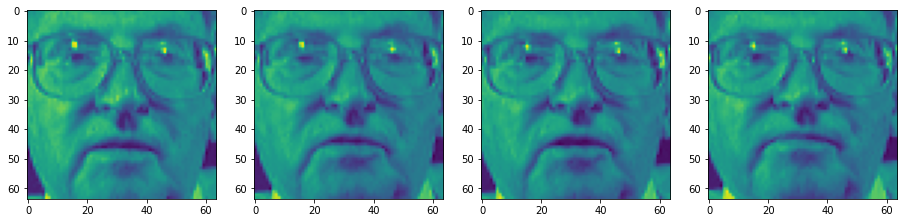

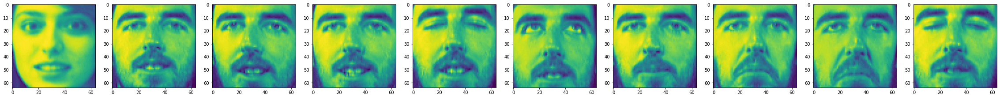

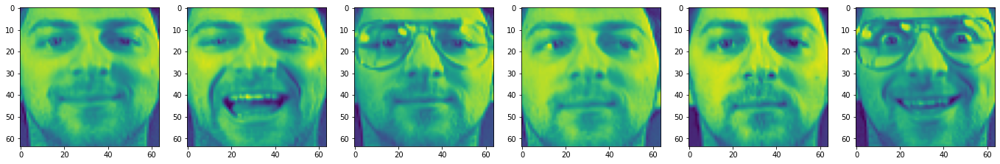

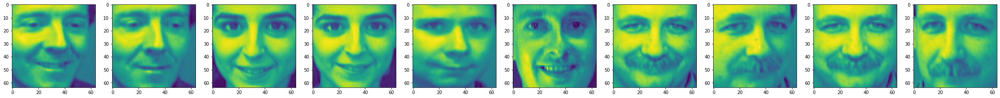

In [ ]:
plt.rcParams['figure.figsize'] = [40, 10]
for cluster in clf.clusters:
    for i in range(min(10,len(cluster))):
        plt.subplot(1,10,i+1)
        plt.imshow(cluster[i].reshape(64,64))
    plt.show()
        
        

In [ ]:
init_cluster_means=[]
for i in range(40):
    idx=np.where(y==i)[0]
    init_cluster_means.append(random.choice(idx))
clf2=KMeans(n_clusters=40,init=X.iloc[init_cluster_means,:])
clf2.fit(X)

/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:1362: RuntimeWarning: Explicit initial center position passed: performing only one init in KMeans instead of n_init=10.
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(init=         0         1         2         3         4         5         6     \
5    0.549587  0.545455  0.541322  0.537190  0.537190  0.533058  0.528926   
15   0.669421  0.681818  0.706612  0.714876  0.719008  0.727273  0.727273   
25   0.190083  0.256198  0.355372  0.425620  0.495868  0.516529  0.574380   
30   0.169421  0.264463  0.219008  0.280992  0.421488  0.549587  0.669421   
43   0.429752  0.458678  0.549587  0.623967  0.673554  0.714876  0.723140   
51   0.685950  0.698347  0.702479  0.706612  0.70661...
342  0.404959  0.409091  0.417355  0.425620  0.446281  0.454545  0.462810  
353  0.128099  0.169421  0.194215  0.198347  0.194215  0.194215  0.198347  
363  0.128099  0.144628  0.157025  0.194215  0.190083  0.194215  0.198347  
373  0.289256  0.239669  0.400826  0.404959  0.293388  0.285124  0.268595  
389  0.309917  0.334711  0.342975  0.351240  0.351240  0.359504  0.367769  
398  0.409091  0.479339  0.524793  0.545455  0.574380  0.590909  0.603306  

[40 rows x 4096 columns],
       n_clusters=40)

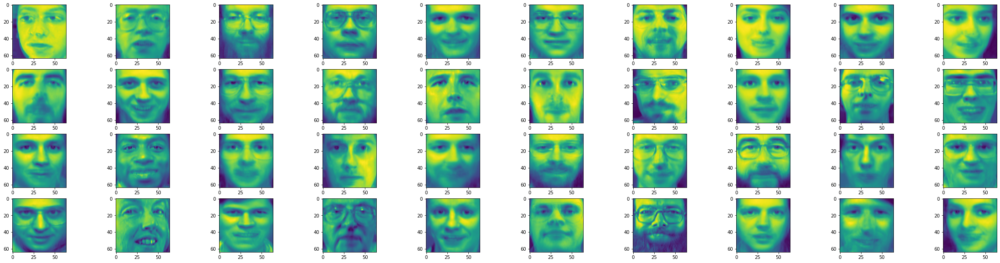

In [ ]:
plt.rcParams['figure.figsize'] = [40, 10]
for idx,x in enumerate(clf2.cluster_centers_):
    plt.subplot(4,10,idx+1)
    plt.imshow(x.reshape(64,64))

2 15 8 6 10 10 6 6 12 7 15 6 11 11 5 13 4 24 6 4 19 10 22 5 24 6 12 9 9 18 8 1 10 10 6 10 5 14 10 11 

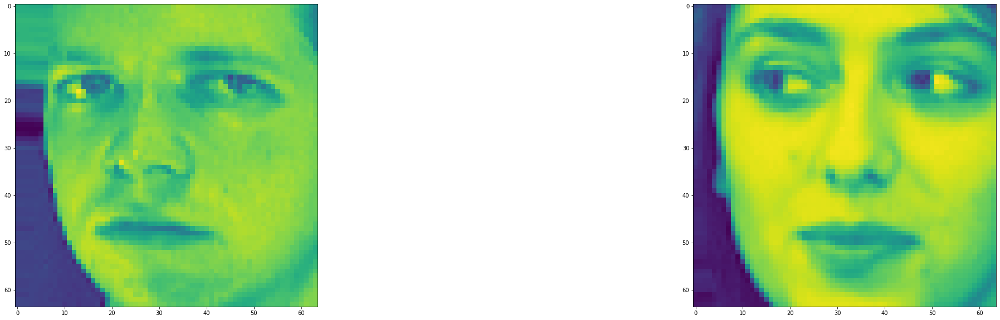

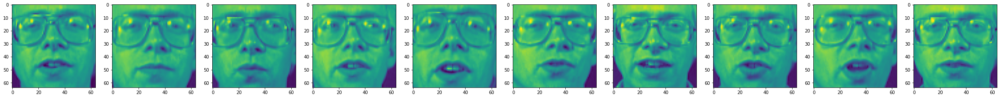

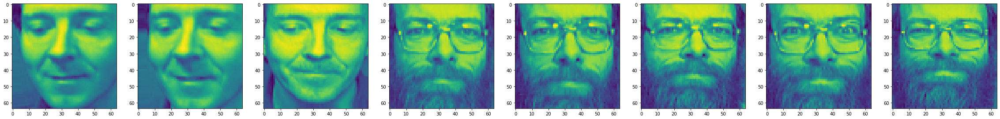

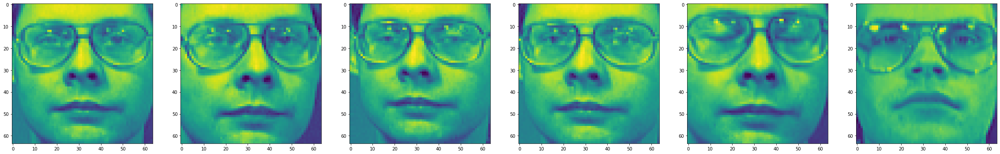

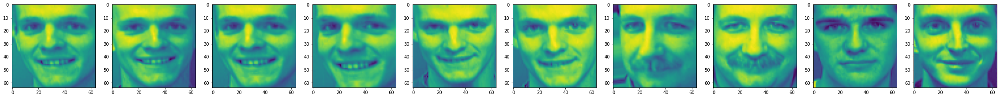

...

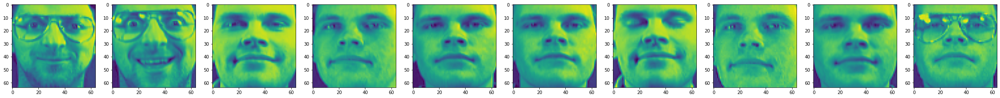

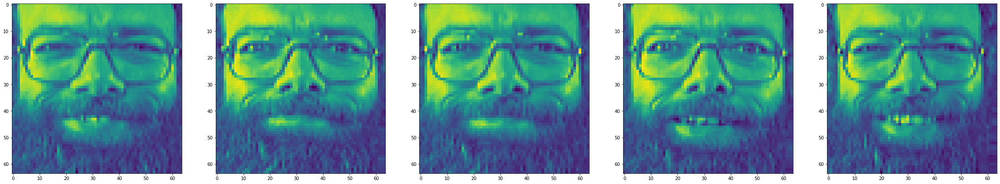

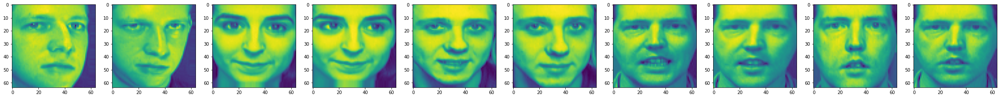

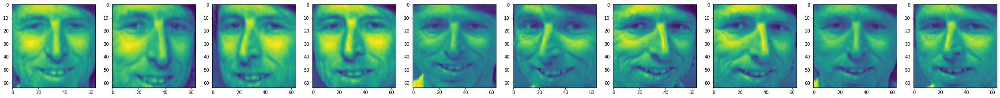

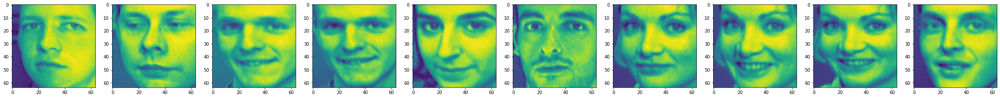

In [ ]:
y=clf2.labels_
clusters=[]
for i in np.unique(y):
    idx=np.where(y==i)[0]
    clusters.append(X.iloc[idx,:].to_numpy())

for cluster in clusters:
    print(len(cluster),end=' ')

for cluster in clusters:
    for i in range(min(10,len(cluster))):
        plt.subplot(1,min(10,len(cluster)),i+1)
        plt.imshow(cluster[i].reshape(64,64))
    plt.show()

In [ ]:




def distance(x,y):
        distance=(x-y)**2
        return distance.sum()

def sse(clf,X):
    cluster_means=clf.cluster_centers_
    # cluster_means=clf.centroids
    sum=0
    
    for x in X:
        # print(x)
        y=clf.predict(x.reshape(1,-1))
        sum+=distance(x,cluster_means[y])
    return sum

print("sse for K means classifier built from scratch",sse(clf,X.to_numpy()))

print("sse for K means classifier from sklearn library",sse(clf2,X.to_numpy()))



sse for K means classifier built from scratch 12724.861604690552
sse for K means classifier from sklearn library 12659.064950942993


#Problem 03

In [31]:
df=pd.read_csv('https://archive.ics.uci.edu/ml/machine-learning-databases/00292/Wholesale%20customers%20data.csv')
df

,Channel,Region,Fresh,Milk,Grocery,Frozen,Detergents_Paper,Delicassen
0,2,3,12669,9656,7561,214,2674,1338
1,2,3,7057,9810,9568,1762,3293,1776
2,2,3,6353,8808,7684,2405,3516,7844
3,1,3,13265,1196,4221,6404,507,1788
4,2,3,22615,5410,7198,3915,1777,5185
...,...,...,...,...,...,...,...,...
435,1,3,29703,12051,16027,13135,182,2204
436,1,3,39228,1431,764,4510,93,2346
437,2,3,14531,15488,30243,437,14841,1867
438,1,3,10290,1981,2232,1038,168,2125


In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 440 entries, 0 to 439
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype
---  ------            --------------  -----
 0   Channel           440 non-null    int64
 1   Region            440 non-null    int64
 2   Fresh             440 non-null    int64
 3   Milk              440 non-null    int64
 4   Grocery           440 non-null    int64
 5   Frozen            440 non-null    int64
 6   Detergents_Paper  440 non-null    int64
 7   Delicassen        440 non-null    int64
dtypes: int64(8)
memory usage: 27.6 KB


In [33]:
df=(df-df.min())/(df.max()-df.min())
df

,Channel,Region,Fresh,Milk,Grocery,Frozen,Detergents_Paper,Delicassen
0,1.0,1.0,0.112940,0.130727,0.081464,0.003106,0.065427,0.027847
1,1.0,1.0,0.062899,0.132824,0.103097,0.028548,0.080590,0.036984
2,1.0,1.0,0.056622,0.119181,0.082790,0.039116,0.086052,0.163559
3,0.0,1.0,0.118254,0.015536,0.045464,0.104842,0.012346,0.037234
4,1.0,1.0,0.201626,0.072914,0.077552,0.063934,0.043455,0.108093
...,...,...,...,...,...,...,...,...
435,0.0,1.0,0.264829,0.163338,0.172715,0.215469,0.004385,0.045912
436,0.0,1.0,0.349761,0.018736,0.008202,0.073713,0.002205,0.048874
437,1.0,1.0,0.129543,0.210136,0.325943,0.006771,0.363463,0.038882
438,0.0,1.0,0.091727,0.026224,0.024025,0.016649,0.004042,0.044264


<AxesSubplot:>

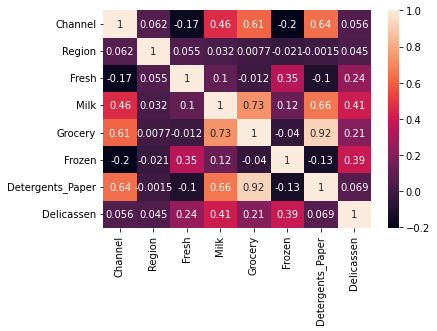

In [34]:
sns.heatmap(df.corr(),annot=True)

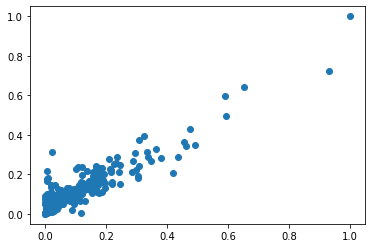

In [35]:
plt.scatter(df['Detergents_Paper'],df['Grocery'])

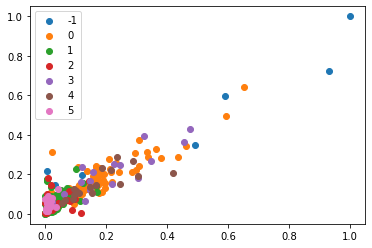

In [36]:
dbscan_clf=DBSCAN().fit(df.to_numpy())
y=dbscan_clf.labels_
for i in np.unique(y):
    idx=np.where(y==i)[0]
    plt.scatter(df['Detergents_Paper'][idx],df['Grocery'][idx],label=i)
plt.legend()
plt.show()

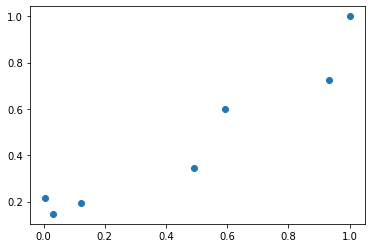

In [37]:
idx=np.where(y==-1)[0]
plt.scatter(df['Detergents_Paper'][idx],df['Grocery'][idx])

/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


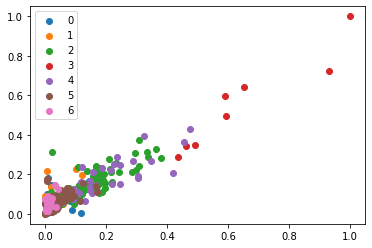

In [38]:
k_means_clf=KMeans(n_clusters=7).fit(df.to_numpy())
y=k_means_clf.labels_
for i in np.unique(y):
    idx=np.where(y==i)[0]
    plt.scatter(df['Detergents_Paper'][idx],df['Grocery'][idx],label=i)
plt.legend()
plt.show()

In [39]:
moon_df=make_moons(n_samples=2000,noise=0.2)
moon_df

(array([[ 0.55722486,  0.99362029],
        [ 0.32653613,  1.10451143],
        [ 0.25349607,  0.00338149],
        ...,
        [ 0.53677489,  0.6950656 ],
        [-0.82166105,  0.93337177],
        [ 0.78390268, -0.66697009]]), array([0, 0, 1, ..., 0, 0, 1]))

In [40]:
make_moon_df=pd.DataFrame(moon_df[0],columns=['X1','X2'])
make_moon_df['Y']=moon_df[1]
make_moon_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   X1      2000 non-null   float64
 1   X2      2000 non-null   float64
 2   Y       2000 non-null   int64  
dtypes: float64(2), int64(1)
memory usage: 47.0 KB


<AxesSubplot:xlabel='X1', ylabel='X2'>

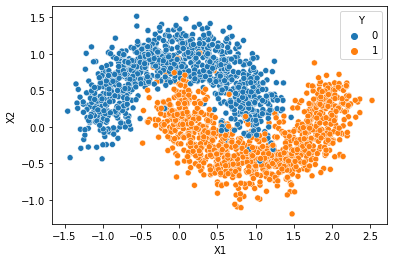

In [41]:
sns.scatterplot(data=make_moon_df,x='X1',y='X2',hue='Y')

0.18999999999999997


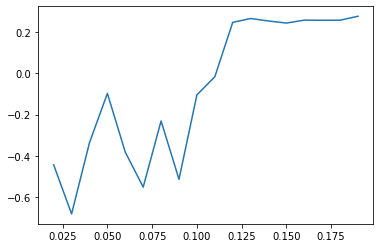

In [66]:
X=make_moon_df.drop('Y',axis=1).to_numpy()
Y=make_moon_df['Y'].to_numpy()
Silhouette_scores=[]
K=np.arange(0.02,0.2,0.01)
# K=[]
for n_clusters in K:
    temp_model=DBSCAN(eps=n_clusters)
    temp_model.fit(X)
    temp_y_pred=temp_model.labels_
    # print(temp_y_pred)
    
    Silhouette_scores.append(silhouette_score(X,temp_y_pred))  
    

# print(K[Silhouette_scores.argmax()])
plt.plot(K,Silhouette_scores)
argmx=Silhouette_scores.index(max(Silhouette_scores))
print(K[argmx])


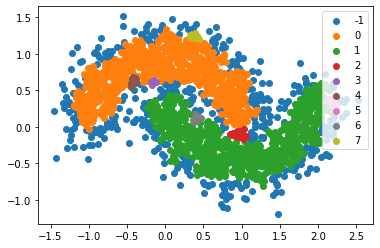

In [74]:
DBscan_moon_clf=DBSCAN(eps=0.08,min_samples=9).fit(X)
y=DBscan_moon_clf.labels_
for i in np.unique(y):
    idx=np.where(y==i)[0]
    plt.scatter(X[idx,0],X[idx,1],label=i)
plt.legend()
plt.show()

/usr/local/lib/python3.8/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


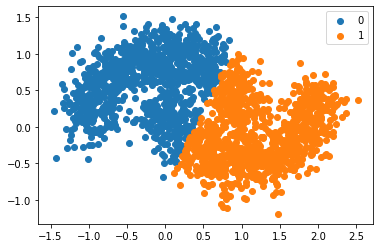

In [61]:
K_means_moon_clf=KMeans(n_clusters=2).fit(X)
y=K_means_moon_clf.labels_
for i in np.unique(y):
    idx=np.where(y==i)[0]
    plt.scatter(X[idx,0],X[idx,1],label=i)
plt.legend()
plt.show()